In [3]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [4]:
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [5]:
DATA_FOLDER = "C:/Users/Sahu Suraj/Videos/New Project/DeepFake Detection/Data/"
TRAIN_SAMPLE_FOLDER = "train_sample_videos"
TEST_FOLDER = "test_videos"

print(f"Train Samples: {len(os.listdir(os.path.join(DATA_FOLDER,TRAIN_SAMPLE_FOLDER)))}")
print(f"Test Samples: {len(os.listdir(os.path.join(DATA_FOLDER,TEST_FOLDER)))}")

Train Samples: 401
Test Samples: 400


In [4]:
train_sample_metadata = pd.read_json("C:/Users/Sahu Suraj/Videos/New Project/DeepFake Detection/Data/train_sample_videos/metadata.json").T
train_sample_metadata.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


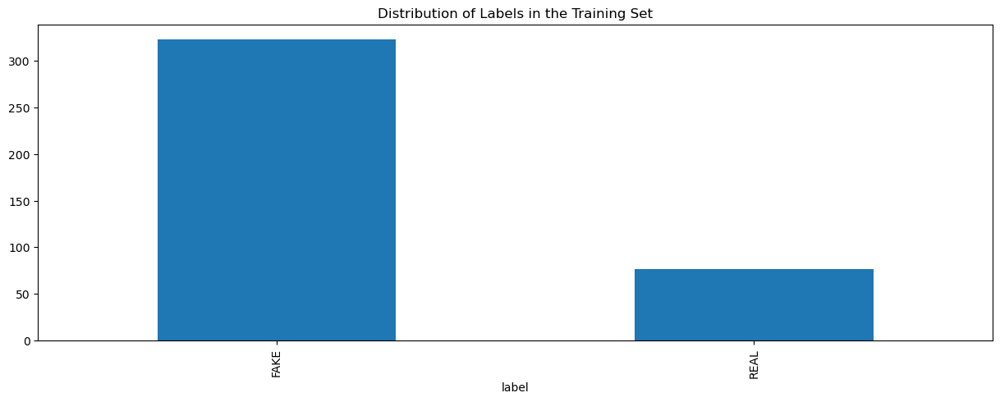

In [5]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15,5),kind='bar',title="Distribution of Labels in the Training Set")
plt.show()

In [6]:
train_sample_metadata.shape

(400, 3)

In [7]:
fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata['label'] == 'FAKE'].sample(10).index)
fake_train_sample_video

['eeyhxisdfh.mp4',
 'bvgwelbeof.mp4',
 'bqqpbzjgup.mp4',
 'bkvetcojbt.mp4',
 'dnhvalzvrt.mp4',
 'adhsbajydo.mp4',
 'degpbqvcay.mp4',
 'dkwjwbwgey.mp4',
 'ctzmavwror.mp4',
 'aknbdpmgua.mp4']

In [8]:
def display_image_from_video(path):
    capture_img = cv2.VideoCapture(path)
    ret , frame = capture_img.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

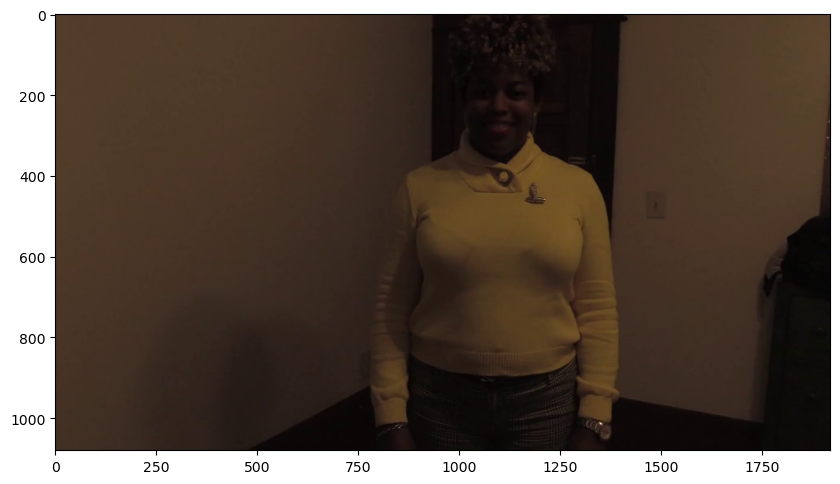

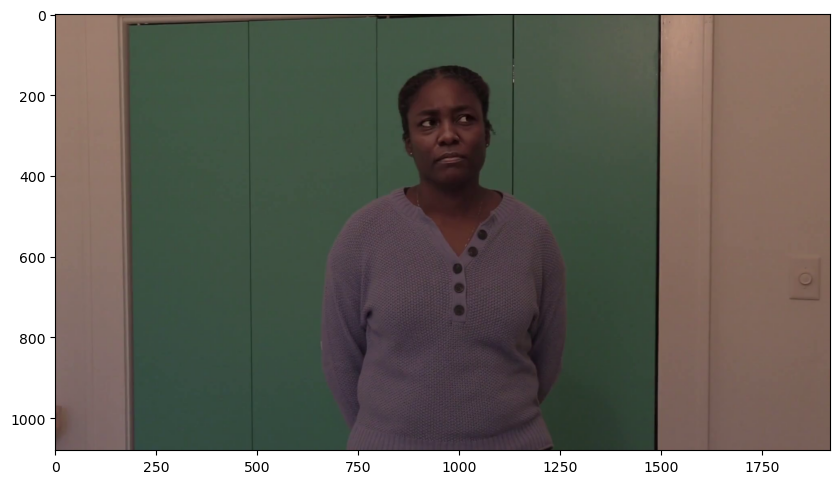

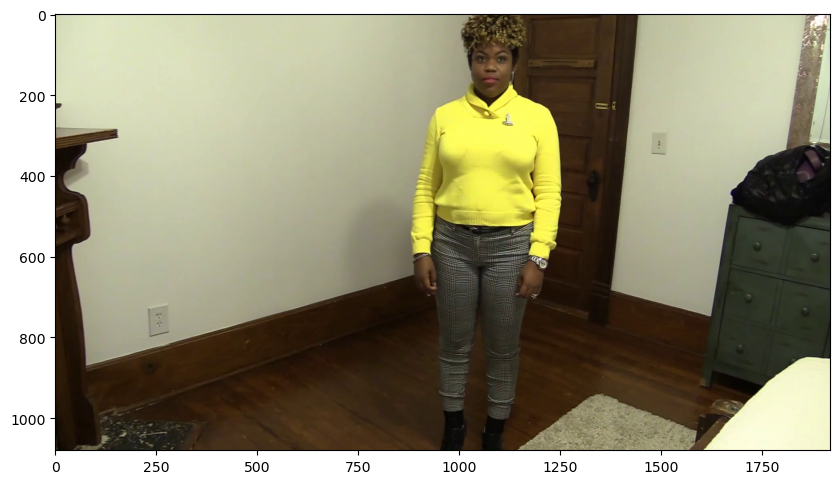

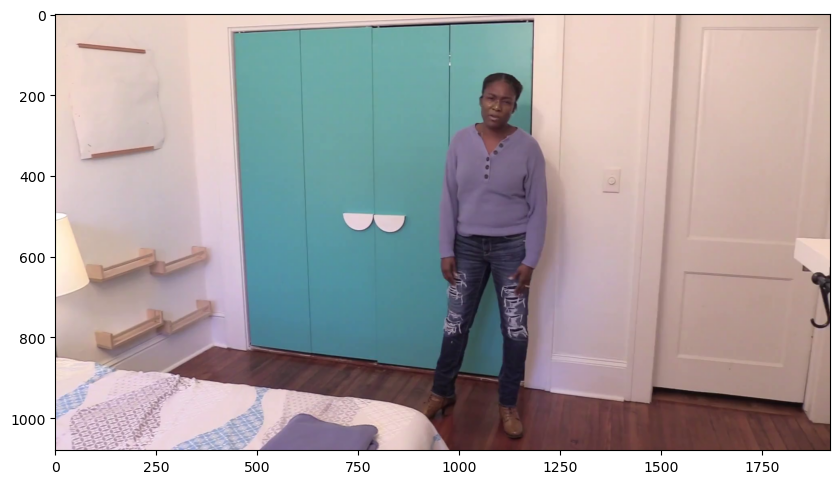

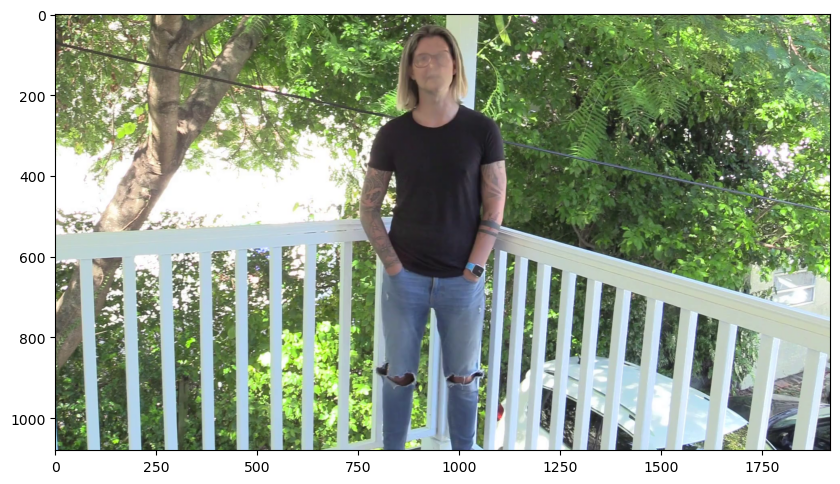

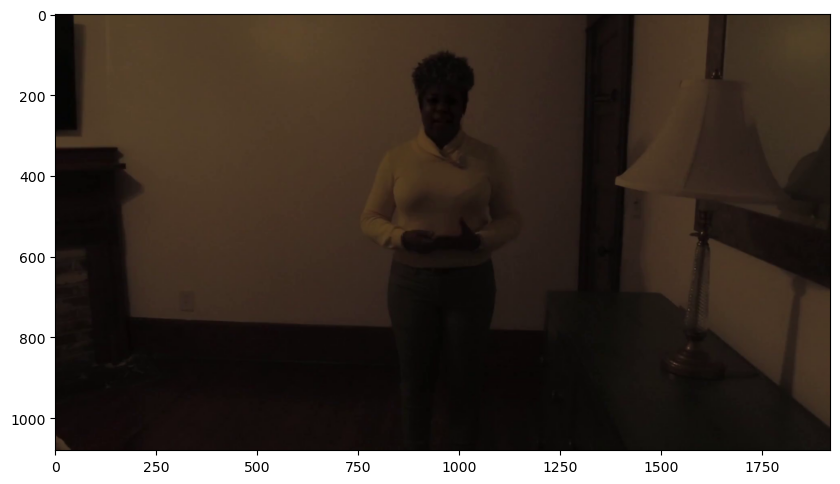

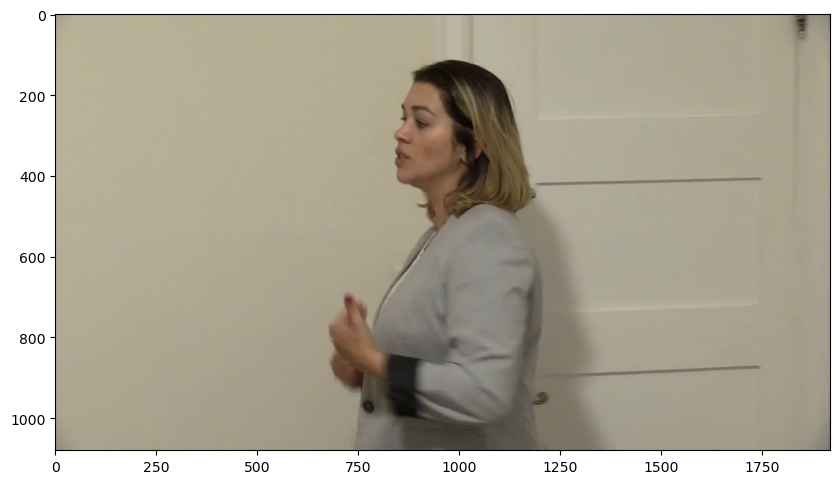

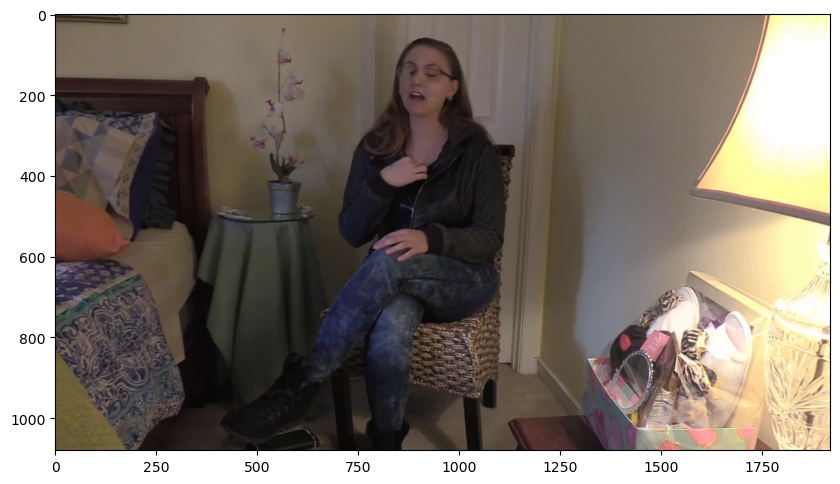

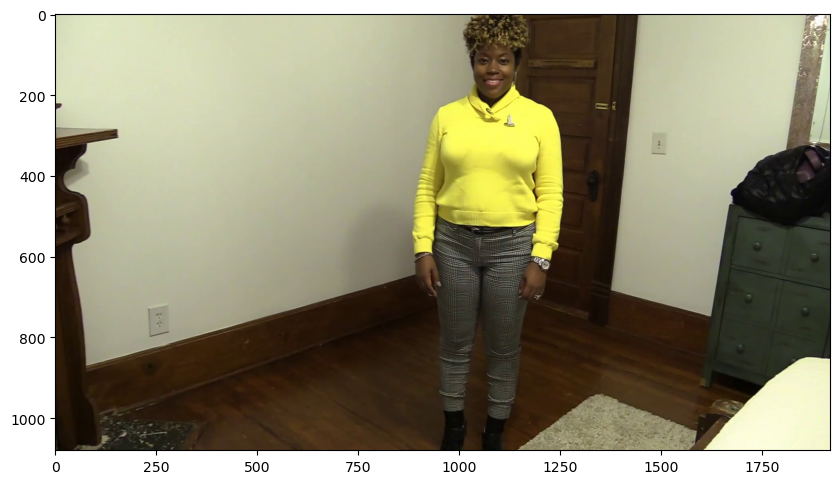

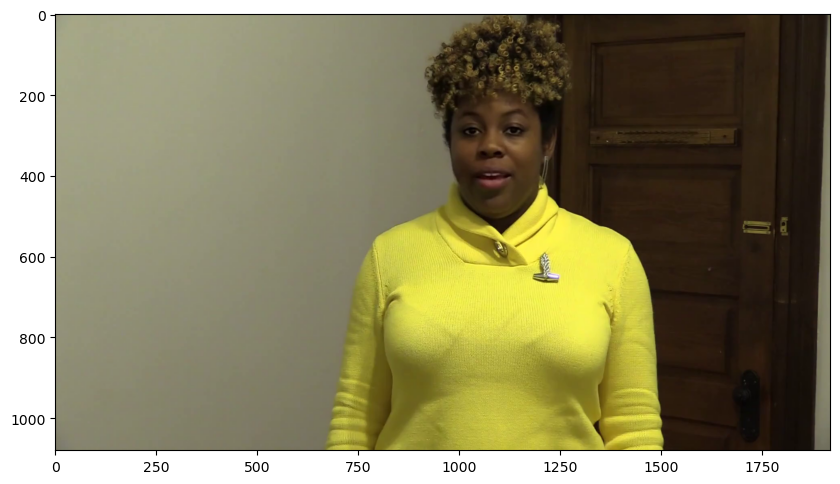

In [9]:
for vid_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER,TRAIN_SAMPLE_FOLDER,vid_file))

In [10]:
train_sample_metadata['original'].value_counts()[0:5]

original
atvmxvwyns.mp4    6
meawmsgiti.mp4    6
qeumxirsme.mp4    5
kgbkktcjxf.mp4    5
fysyrqfguw.mp4    4
Name: count, dtype: int64

In [11]:
def display_image_from_video_list(video_path_list,video_folder = TRAIN_SAMPLE_FOLDER):
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    for i,video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER,video_folder,video_file)
        capture_image = cv2.VideoCapture(video_path)
        ret,frame = capture_image.read()
        frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
        ax[i//3,i%3].imshow(frame)
        ax[i//3,i%3].set_title(f"Video: {video_file}")
        ax[i//3,i%3].axis("on")

<Figure size 640x480 with 0 Axes>

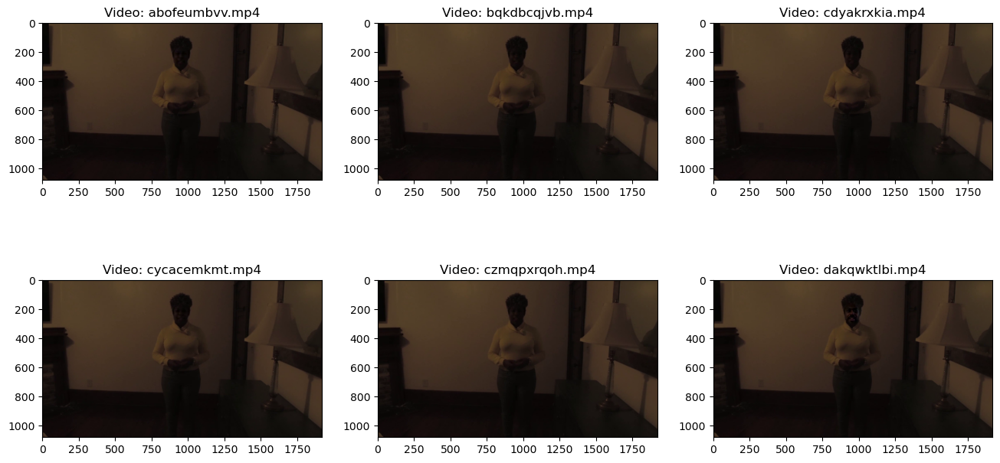

In [12]:
same_original_fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.original == "atvmxvwyns.mp4"].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [13]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER,TEST_FOLDER))),columns=['video'])

In [14]:
test_videos.head()

,video
0,aassnaulhq.mp4
1,aayfryxljh.mp4
2,acazlolrpz.mp4
3,adohdulfwb.mp4
4,ahjnxtiamx.mp4


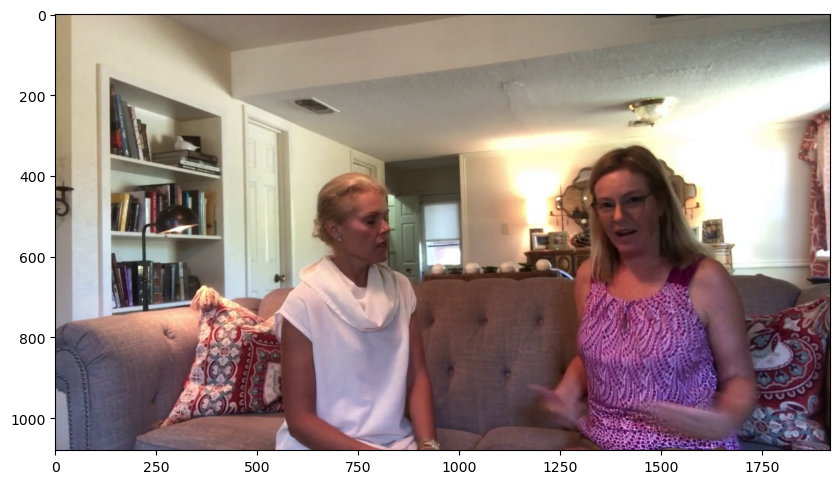

In [15]:
display_image_from_video(os.path.join(DATA_FOLDER,TEST_FOLDER,test_videos.iloc[2].video))

In [16]:
fake_videos = list(train_sample_metadata.loc[train_sample_metadata.label =='FAKE'].index)

In [17]:
from IPython.display import HTML
from base64 import b64encode
def play_video(video_file,subset = TRAIN_SAMPLE_FOLDER):
    video_url = open(os.path.join(DATA_FOLDER,subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>"""%data_url)
play_video(fake_videos[10])

In [18]:
IMG_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 10

MAX_SEQ_LENGTH = 20
NUM_FEATURES =2048

In [2]:
def crop_center_square(frame):
    y,x = frame.shape[0:2]
    min_dim = min(y,x)
    start_x = (x//2) - (min_dim//2)
    start_y = (y//2) - (min_dim//2)
    return frame[start_y: start_y + min_dim, start_x: start_x + min_dim]

def load_video(path,max_frames=0,resize=(IMG_SIZE,IMG_SIZE)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame,resize)
            frame = frame[:,:,[2,1,0]]
            frames.append(frame)
            
            if len(frames) ==max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)

In [20]:
def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(
        weights='imagenet',
        include_top=False,
        pooling = "avg",
        input_shape = (IMG_SIZE,IMG_SIZE,3),
    )
    preprocess_input = keras.applications.inception_v3.preprocess_input
    
    inputs = keras.Input((IMG_SIZE,IMG_SIZE,3))
    preprocessed = preprocess_input(inputs)
    
    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs,outputs,name='feature_extractor')

feature_extractor = build_feature_extractor()

In [31]:
def prepare_all_videos(df,root_dir):
    num_samples = len(df)
    video_paths = list(df.index)
    labels = df['label'].values
    labels = np.array(labels=='FAKE').astype('int')
    
    frame_masks= np.zeros(shape=(num_samples,MAX_SEQ_LENGTH),dtype='bool')
    frame_features = np.zeros(
        shape=(num_samples,MAX_SEQ_LENGTH,NUM_FEATURES),dtype="float32"
    )
    
    for idx, path in enumerate(video_paths):
        frames = load_video(os.path.join(root_dir,path))
        frames = frames[None,...]
        
        temp_frame_mask = np.zeros(shape=(1,MAX_SEQ_LENGTH,),dtype='bool')
        temp_frame_features = np.zeros(
        shape=(1,MAX_SEQ_LENGTH,NUM_FEATURES),dtype="float32"
        )
        
        for i,batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH,video_length)
            for j in range(length):
                temp_frame_features[i,j,:] = feature_extractor.predict(batch[None,j,:])
            temp_frame_mask[i,:length] =1
        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()
    return (frame_features,frame_masks),labels

In [32]:
from sklearn.model_selection import train_test_split

Train_set , Test_set = train_test_split(train_sample_metadata,test_size = 0.2,random_state=42,stratify=train_sample_metadata['label'])

print(Train_set.shape,Test_set.shape)

(320, 3) (80, 3)


In [33]:
train_data,train_labels = prepare_all_videos(Train_set,'train')
test_data,test_labels = prepare_all_videos(Test_set,'test')

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame features in test set: {train_data[1].shape}")


Frame features in train set: (320, 20, 2048)
Frame features in test set: (320, 20)


In [34]:
frame_features_input = keras.Input((MAX_SEQ_LENGTH,NUM_FEATURES))
mask_input = keras.Input((MAX_SEQ_LENGTH,),dtype='bool')

x = keras.layers.GRU(16,return_sequences=True)(
    frame_features_input,mask = mask_input
)
x = keras.layers.GRU(8)(x)
x = keras.layers.Dropout(0.4)(x)
x = keras.layers.Dense(8,activation='relu')(x)
output = keras.layers.Dense(1,activation='sigmoid')(x)

model = keras.Model([frame_features_input,mask_input],output)

model.compile(loss="binary_crossentropy",optimizer="adam",metrics=["accuracy"])
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 20, 2048)  │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_3       │ (None, 20)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru (GRU)           │ (None, 20, 16)    │     99,168 │ input_layer_2[0]… │
│                     │                   │            │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_1 (GRU)         │ (None, 8)         │        624 │ gru[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 8)         │          0 │ gru_1[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 8)         │         72 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 1)         │          9 │ dense[0][0]       │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 99,873 (390.13 KB)

 Trainable params: 99,873 (390.13 KB)

 Non-trainable params: 0 (0.00 B)

In [40]:
import keras
checkpoint = keras.callbacks.ModelCheckpoint('.weights.h5',save_weights_only=True,save_best_only=True)
history = model.fit(
    [train_data[0],train_data[1]],
    train_labels,
    validation_data = ([test_data[0],test_data[1]],test_labels),
    callbacks = [checkpoint],
    epochs=EPOCHS,
    batch_size = BATCH_SIZE
) 

Epoch 1/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 6s 128ms/step - accuracy: 0.6212 - loss: 0.6924 - val_accuracy: 0.8125 - val_loss: 0.6901
Epoch 2/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - accuracy: 0.8087 - loss: 0.6894 - val_accuracy: 0.8125 - val_loss: 0.6871
Epoch 3/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.8005 - loss: 0.6866 - val_accuracy: 0.8125 - val_loss: 0.6841
Epoch 4/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.8080 - loss: 0.6835 - val_accuracy: 0.8125 - val_loss: 0.6811
Epoch 5/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.8062 - loss: 0.6807 - val_accuracy: 0.8125 - val_loss: 0.6782
Epoch 6/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.8399 - loss: 0.6762 - val_accuracy: 0.8125 - val_loss: 0.6753
Epoch 7/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.8147 - loss: 0.6744 - val_accuracy: 0.8125 - val_loss: 0.6724
Epoch 8/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.7944 - loss: 0.6730 - val_accuracy: 0.8125 - 

In [43]:
frame_features_input = keras.Input((MAX_SEQ_LENGTH,NUM_FEATURES))
mask_input = keras.Input((MAX_SEQ_LENGTH,),dtype='bool')

x = keras.layers.GRU(64,return_sequences=True)(frame_features_input,mask = mask_input)
x =keras.layers.BatchNormalization()(x)
x = keras.layers.GRU(32,return_sequences=True)(x)
x =keras.layers.BatchNormalization()(x)
x = keras.layers.GRU(16)(x)
x = keras.layers.Dropout(0.5)(x)
x = keras.layers.Dense(32,activation='relu')(x)
x = keras.layers.Dropout(0.5)(x)
output = keras.layers.Dense(1,activation='sigmoid')(x)

model = keras.Model([frame_features_input,mask_input],output)

optimizer = keras.optimizers.Adam(learning_rate=1e-4)

model.compile(loss="binary_crossentropy",optimizer=optimizer,metrics=["accuracy"])
model.summary()

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss',patience=5,restore_best_weights=True)
checkpoint = keras.callbacks.ModelCheckpoint('.weights.h5',save_weights_only=True,save_best_only=True)
history = model.fit(
    [train_data[0],train_data[1]],
    train_labels,
    validation_data = ([test_data[0],test_data[1]],test_labels),
    callbacks = [checkpoint,early_stopping],
    epochs=30,
    batch_size = 16
) 

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 20, 2048)  │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_5       │ (None, 20)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_2 (GRU)         │ (None, 20, 64)    │    405,888 │ input_layer_4[0]… │
│                     │                   │            │ input_layer_5[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 20, 64)    │        256 │ gru_2[0][0]       │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_3 (GRU)         │ (None, 20, 32)    │      9,408 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 20, 32)    │        128 │ gru_3[0][0]       │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_4 (GRU)         │ (None, 16)        │      2,400 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 16)        │          0 │ gru_4[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 32)        │        544 │ dropout_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 32)        │          0 │ dense_2[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 1)         │         33 │ dropout_2[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 418,657 (1.60 MB)

 Trainable params: 418,465 (1.60 MB)

 Non-trainable params: 192 (768.00 B)

Epoch 1/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.7041 - loss: 0.6930 - val_accuracy: 0.8125 - val_loss: 0.6925
Epoch 2/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step - accuracy: 0.8040 - loss: 0.6924 - val_accuracy: 0.8125 - val_loss: 0.6919
Epoch 3/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step - accuracy: 0.7913 - loss: 0.6919 - val_accuracy: 0.8125 - val_loss: 0.6913
Epoch 4/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - accuracy: 0.8370 - loss: 0.6910 - val_accuracy: 0.8125 - val_loss: 0.6907
Epoch 5/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step - accuracy: 0.8036 - loss: 0.6907 - val_accuracy: 0.8125 - val_loss: 0.6901
Epoch 6/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.8196 - loss: 0.6899 - val_accuracy: 0.8125 - val_loss: 0.6895
Epoch 7/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - accuracy: 0.7572 - loss: 0.6900 - val_accuracy: 0.8125 - val_loss: 0.6890
Epoch 8/30
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - accuracy: 0.8024 - loss: 0.6890 - val_accuracy: 0.8125 - 

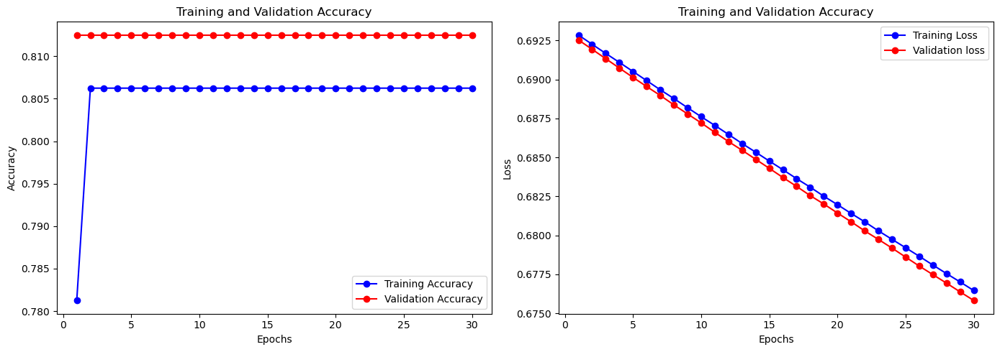

In [45]:
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1,len(accuracy)+1)

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.plot(epochs,accuracy,'bo-',label = 'Training Accuracy')
plt.plot(epochs,val_accuracy,'ro-',label="Validation Accuracy")
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1,2,2)
plt.plot(epochs,loss,'bo-',label = 'Training Loss')
plt.plot(epochs,val_loss,'ro-',label="Validation loss")
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

In [51]:
from IPython import embed
def prepare_single_video(frames):
    frames=frames[None,...]
    frame_mask = np.zeros(shape=(1,MAX_SEQ_LENGTH,),dtype='bool')
    frame_features = np.zeros(shape=(1,MAX_SEQ_LENGTH,NUM_FEATURES),dtype='float32')
    
    for i,batch in enumerate(frames):
        Video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH,Video_length)
        for j in range(length):
            frame_features[i,j,:] = feature_extractor.predict(batch[None,j,:])
        frame_mask[i,:length] =  1
    return frame_features,frame_mask

def sequence_prediction(path):
    frames = load_video(os.path.join(DATA_FOLDER,TEST_FOLDER,path))
    frame_features , frame_mask = prepare_single_video(frames)
    return model.predict([frame_features,frame_mask])[0]

def to_gif(images):
    converted_img = images.astype(np.uint8)
    imageio.mimsave("animation.gif",converted_img,fps=10)
    return embed.embed_file("animation.gif")

test_video = np.random.choice(test_videos["video"].values.tolist())
print(f"Test video path: {test_video}")

if(sequence_prediction(test_video)>=0.5):
    print(f"The Predicted class of the video is FAKE")
else:
    print(f"The Predicted class of the video is REAL")

play_video(test_video,TEST_FOLDER)

Test video path: coqwgzpbhx.mp4
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step
The Predicted class of the video is FAKE


In [52]:
model.save('deepfake_video_model.weights.h5')

In [53]:
# model.save('deepfake_video_model.keras')